# Final Project
__Experiment Environment:__

python=3.10

jupyter notebook

pandas

numpy

matplotlib

scikit-learn

liac-arff

### Import libraries

In [33]:
import arff
import pprint

import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder

import matplotlib.pyplot as plt

### arff to csv
Try to translate the arff file to csv. Can be ignored.

In [2]:
def arff_to_csv(fpath):
    # read arff file
    if fpath.find('.arff') < 0:
        print('the file is nott .arff file')
        return
    f = open(fpath)
    lines = f.readlines()
    content = []
    for l in lines:
        content.append(l)
    datas = []
    for c in content:
        cs = c.split(',')
        datas.append(cs)

    # save data into csv file
    df = pd.DataFrame(data=datas,index=None,columns=None)
    filename = fpath[:fpath.find('.arff')] + '.csv'
    df.to_csv(filename,index=None)

# arff_to_csv("speeddating.arff")

### Load Data

In [2]:
dataset = arff.load(open('speeddating.arff', 'r'))
pprint.pprint(dataset)

{'attributes': [('has_null', ['0', '1']),
                ('wave', 'NUMERIC'),
                ('gender', ['female', 'male']),
                ('age', 'NUMERIC'),
                ('age_o', 'NUMERIC'),
                ('d_age', 'NUMERIC'),
                ('d_d_age', ['[4-6]', '[0-1]', '[2-3]', '[7-37]']),
                ('race',
                 ['Asian/Pacific Islander/Asian-American',
                  'European/Caucasian-American',
                  'Other',
                  'Latino/Hispanic American',
                  'Black/African American']),
                ('race_o',
                 ['European/Caucasian-American',
                  'Asian/Pacific Islander/Asian-American',
                  'Latino/Hispanic American',
                  'Other',
                  'Black/African American']),
                ('samerace', ['0', '1']),
                ('importance_same_race', 'NUMERIC'),
                ('importance_same_religion', 'NUMERIC'),
                ('d_importance_same

In [3]:
data = np.array(dataset['data'])
print(data)
print(data.shape)
print(data[0])

[['0' 1.0 'female' ... '1' '0' '0']
 ['0' 1.0 'female' ... '1' '0' '0']
 ['1' 1.0 'female' ... '1' '1' '1']
 ...
 ['1' 21.0 'male' ... '0' '0' '0']
 ['1' 21.0 'male' ... '0' '1' '0']
 ['1' 21.0 'male' ... '0' '1' '0']]
(8378, 123)
['0' 1.0 'female' 21.0 27.0 6.0 '[4-6]'
 'Asian/Pacific Islander/Asian-American' 'European/Caucasian-American' '0'
 2.0 4.0 '[2-5]' '[2-5]' 'Law' 35.0 20.0 20.0 20.0 0.0 5.0 '[21-100]'
 '[16-20]' '[16-20]' '[16-20]' '[0-15]' '[0-15]' 6.0 8.0 8.0 8.0 8.0 6.0
 '[6-8]' '[6-8]' '[6-8]' '[6-8]' '[6-8]' '[6-8]' 15.0 20.0 20.0 15.0 15.0
 15.0 '[0-15]' '[16-20]' '[16-20]' '[0-15]' '[0-15]' '[0-15]' 6.0 8.0 8.0
 8.0 7.0 '[6-8]' '[6-8]' '[6-8]' '[6-8]' '[6-8]' 6.0 9.0 7.0 7.0 6.0 5.0
 '[6-8]' '[9-10]' '[6-8]' '[6-8]' '[6-8]' '[0-5]' 9.0 2.0 8.0 9.0 1.0 1.0
 5.0 1.0 5.0 6.0 9.0 1.0 10.0 10.0 9.0 8.0 1.0 '[9-10]' '[0-5]' '[6-8]'
 '[9-10]' '[0-5]' '[0-5]' '[0-5]' '[0-5]' '[0-5]' '[6-8]' '[9-10]' '[0-5]'
 '[9-10]' '[9-10]' '[9-10]' '[6-8]' '[0-5]' 0.14 '[0-0.33]' 3.0 2.0 4

In [4]:
attributes = [attr[0] for attr in dataset['attributes']] # extract the attributes
df = pd.DataFrame(data, columns=attributes) # transform to pandas dataframe
print(df.head(1))
print(df.dtypes)

  has_null wave  gender   age age_o d_age d_d_age  \
0        0  1.0  female  21.0  27.0   6.0   [4-6]   

                                    race                       race_o  \
0  Asian/Pacific Islander/Asian-American  European/Caucasian-American   

  samerace  ... d_expected_num_interested_in_me d_expected_num_matches like  \
0        0  ...                           [0-3]                  [3-5]  7.0   

  guess_prob_liked d_like d_guess_prob_liked  met decision decision_o match  
0              6.0  [6-8]              [5-6]  0.0        1          0     0  

[1 rows x 123 columns]
has_null              object
wave                  object
gender                object
age                   object
age_o                 object
                       ...  
d_guess_prob_liked    object
met                   object
decision              object
decision_o            object
match                 object
Length: 123, dtype: object


### Preprocessing

In [5]:
# only feature 107 (count from 0) "interests_correlate" is float. Other numerical features are int.
types = [attr[1] for attr in dataset['attributes']]
print(types)
print([type(element) for element in types])

[['0', '1'], 'NUMERIC', ['female', 'male'], 'NUMERIC', 'NUMERIC', 'NUMERIC', ['[4-6]', '[0-1]', '[2-3]', '[7-37]'], ['Asian/Pacific Islander/Asian-American', 'European/Caucasian-American', 'Other', 'Latino/Hispanic American', 'Black/African American'], ['European/Caucasian-American', 'Asian/Pacific Islander/Asian-American', 'Latino/Hispanic American', 'Other', 'Black/African American'], ['0', '1'], 'NUMERIC', 'NUMERIC', ['[2-5]', '[6-10]', '[0-1]'], ['[2-5]', '[0-1]', '[6-10]'], ['Law', 'law', 'Economics', 'Masters in Public Administration', 'Masters of Social Work&Education', 'Finance', 'Business', 'political science', 'money', 'Operations Research', 'TC [Health Ed]', 'Psychology', 'social work', 'Social Work', 'Speech Language Pathology', 'Speech Languahe Pathology', 'Educational Psychology', 'Applied Maths/Econs', 'Mathematics', 'Statistics', 'Organizational Psychology', 'Mechanical Engineering', 'Finanace', 'Finance&Economics', 'Undergrad - GS', 'Mathematical Finance', 'Medicine', 

In [23]:
# replace ? to NaN
df.replace('?', np.nan, inplace=True)
print(df.iloc[2, 116])

nan


In [46]:
# transform string to numeric
for index, element in enumerate(types):
    if isinstance(element, str):
        df.iloc[:, index] = pd.to_numeric(df.iloc[:, index], errors='coerce').astype(float)

# transform categories to numeric
label_encoder = LabelEncoder()
for index, element in enumerate(types):
    if isinstance(element, list):
        df.iloc[:, index] = label_encoder.fit_transform(df.iloc[:, index])

print(df.iloc[0, 0:7])
print(df.iloc[2, 0:7])
print(df.dtypes)

has_null     0.0
wave         1.0
gender       0.0
age         21.0
age_o       27.0
d_age        6.0
d_d_age      2.0
Name: 0, dtype: float64
has_null     1.0
wave         1.0
gender       0.0
age         21.0
age_o       22.0
d_age        1.0
d_d_age      0.0
Name: 2, dtype: float64
has_null                int64
wave                  float64
gender                  int64
age                   float64
age_o                 float64
                       ...   
d_guess_prob_liked      int64
met                   float64
decision                int64
decision_o              int64
match                   int64
Length: 123, dtype: object


In [24]:
# determines whether there is a null value in the classification type features
hasnull = False
for index, element in enumerate(types):
    if isinstance(element, list):
        hasnull = hasnull | df.iloc[:, index].isnull().any()
print(hasnull) # null values are numeric types

proportion = df['has_null'].mean()
print(f"The proportion of data who has null value: {proportion:.2f}")
# 0.87 indicates that we can't drop row that has null values directly

False
The proportion of data who has null value: 0.87


#### Data Exploration

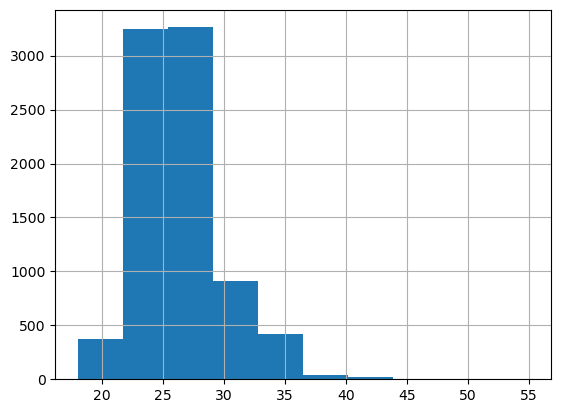

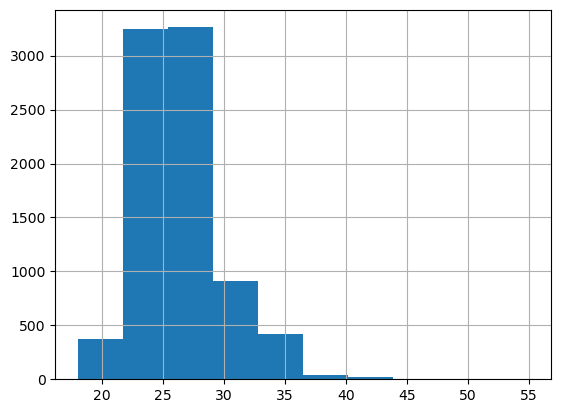

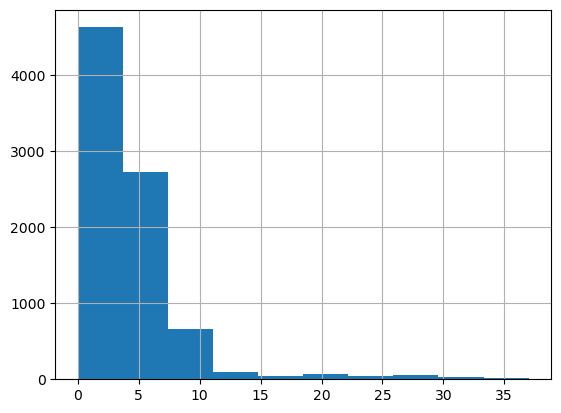

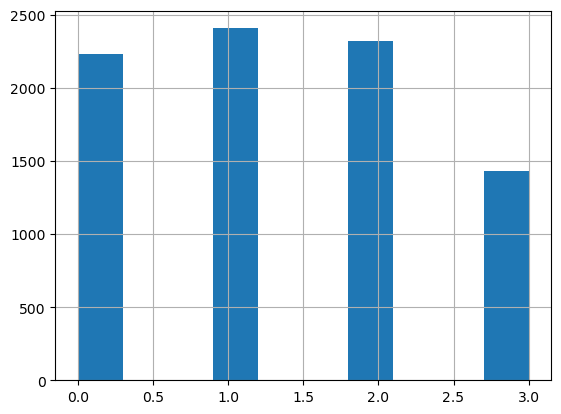

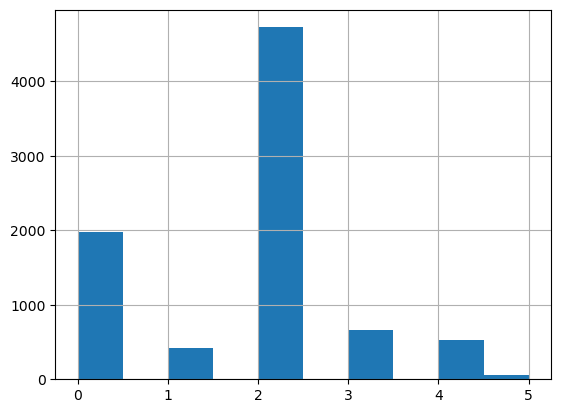

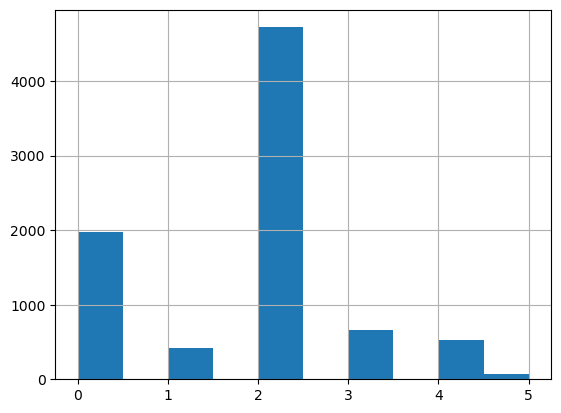

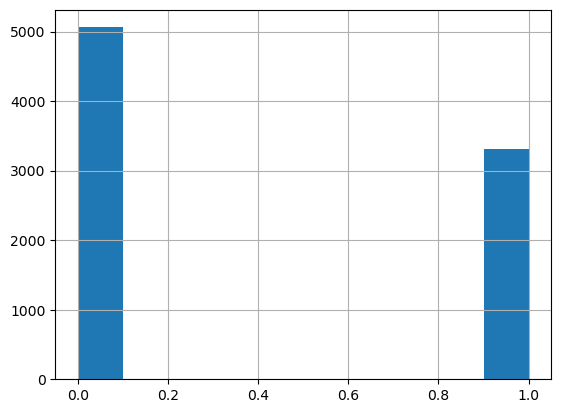

In [36]:
# I only show some of the features because 123 is too much
# You can modify the following code scope if necessary.
for i in range(3, 10):
    plt.figure()
    df.iloc[:, i].hist()
    plt.show()

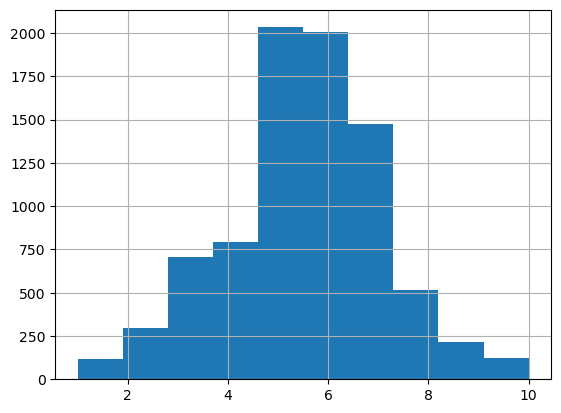

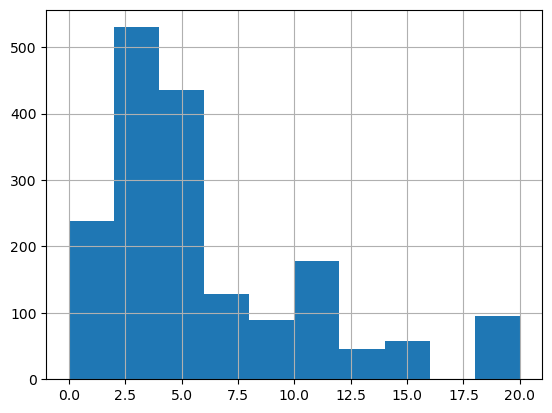

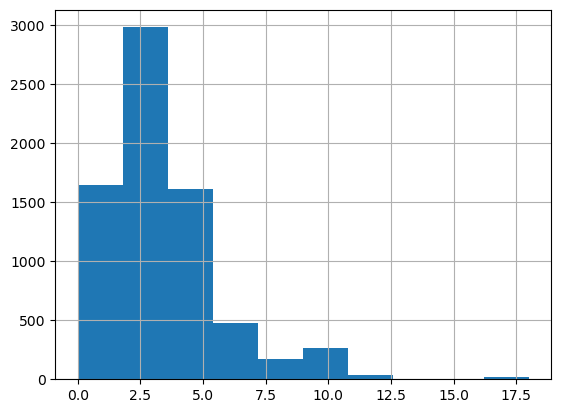

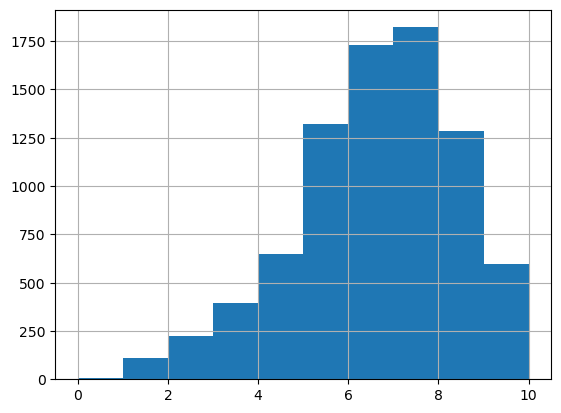

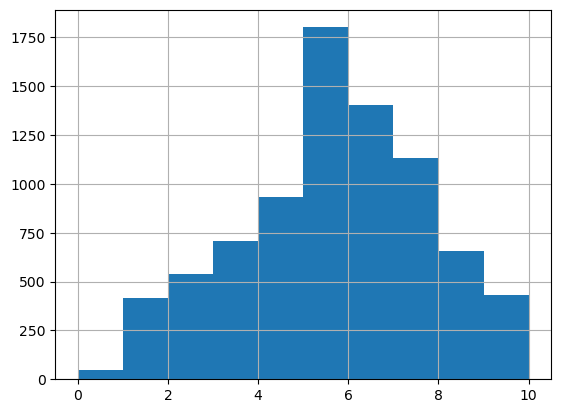

In [37]:
# take a look to the features that have a lot of null values
selected_features = [109, 110, 111, 115, 116]
for i in selected_features:
    plt.figure()
    df.iloc[:, i].hist()
    plt.show()

#### Fill Null Values

In [47]:
# Since most of the features that have null valuse are skew distribution,
# fill null values with medians

# df = df.fillna(df.median(numeric_only=True))
df = df.fillna(df.median())

# check if the null value has been filled
hasnull = False
for index, element in enumerate(types):
    if isinstance(element, str):
        hasnull = hasnull | df.iloc[:, index].isnull().any()
print(hasnull)

False


In [ ]:
# filtered_data = data[data[:, 0] == '0'] # filter out the rows whose first column is 1, i.e. have null value
# result = filtered_data[:, 1:] # remove first column

# print(result)
# print(result.shape)